# Importing libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Loading data

In [2]:
df = pd.read_csv('voice.csv',)

# column details

In [3]:
df.columns

Index(['meanfreq', 'sd', 'median', 'Q25', 'Q75', 'IQR', 'skew', 'kurt',
       'sp.ent', 'sfm', 'mode', 'centroid', 'meanfun', 'minfun', 'maxfun',
       'meandom', 'mindom', 'maxdom', 'dfrange', 'modindx', 'label'],
      dtype='object')

In [4]:
df.shape

(3168, 21)

In [5]:
df.isnull().sum()

meanfreq    0
sd          0
median      0
Q25         0
Q75         0
IQR         0
skew        0
kurt        0
sp.ent      0
sfm         0
mode        0
centroid    0
meanfun     0
minfun      0
maxfun      0
meandom     0
mindom      0
maxdom      0
dfrange     0
modindx     0
label       0
dtype: int64

In [6]:
df.head(10)

,meanfreq,sd,median,Q25,Q75,IQR,skew,kurt,sp.ent,sfm,...,centroid,meanfun,minfun,maxfun,meandom,mindom,maxdom,dfrange,modindx,label
0,0.059781,0.064241,0.032027,0.015071,0.090193,0.075122,12.863462,274.402906,0.893369,0.491918,...,0.059781,0.084279,0.015702,0.275862,0.007812,0.007812,0.007812,0.000000,0.000000,male
1,0.066009,0.067310,0.040229,0.019414,0.092666,0.073252,22.423285,634.613855,0.892193,0.513724,...,0.066009,0.107937,0.015826,0.250000,0.009014,0.007812,0.054688,0.046875,0.052632,male
2,0.077316,0.083829,0.036718,0.008701,0.131908,0.123207,30.757155,1024.927705,0.846389,0.478905,...,0.077316,0.098706,0.015656,0.271186,0.007990,0.007812,0.015625,0.007812,0.046512,male
3,0.151228,0.072111,0.158011,0.096582,0.207955,0.111374,1.232831,4.177296,0.963322,0.727232,...,0.151228,0.088965,0.017798,0.250000,0.201497,0.007812,0.562500,0.554688,0.247119,male
4,0.135120,0.079146,0.124656,0.078720,0.206045,0.127325,1.101174,4.333713,0.971955,0.783568,...,0.135120,0.106398,0.016931,0.266667,0.712812,0.007812,5.484375,5.476562,0.208274,male
5,0.132786,0.079557,0.119090,0.067958,0.209592,0.141634,1.932562,8.308895,0.963181,0.738307,...,0.132786,0.110132,0.017112,0.253968,0.298222,0.007812,2.726562,2.718750,0.125160,male
6,0.150762,0.074463,0.160106,0.092899,0.205718,0.112819,1.530643,5.987498,0.967573,0.762638,...,0.150762,0.105945,0.026230,0.266667,0.479620,0.007812,5.312500,5.304688,0.123992,male
7,0.160514,0.076767,0.144337,0.110532,0.231962,0.121430,1.397156,4.766611,0.959255,0.719858,...,0.160514,0.093052,0.017758,0.144144,0.301339,0.007812,0.539062,0.531250,0.283937,male
8,0.142239,0.078018,0.138587,0.088206,0.208587,0.120381,1.099746,4.070284,0.970723,0.770992,...,0.142239,0.096729,0.017957,0.250000,0.336476,0.007812,2.164062,2.156250,0.148272,male
9,0.134329,0.080350,0.121451,0.075580,0.201957,0.126377,1.190368,4.787310,0.975246,0.804505,...,0.134329,0.105881,0.019300,0.262295,0.340365,0.015625,4.695312,4.679688,0.089920,male


In [7]:
df['label'] = df['label'].map({'male':0,'female':1})

In [8]:
Y = df['label']
X = df.drop('label',axis=1)

In [9]:
Y.head(10)

0    0
1    0
2    0
3    0
4    0
5    0
6    0
7    0
8    0
9    0
Name: label, dtype: int64

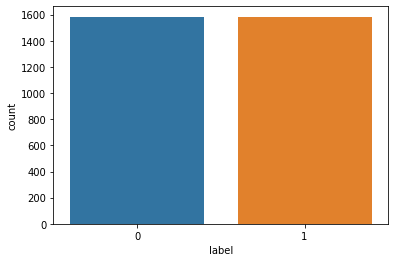

In [10]:
sns.countplot(Y)
plt.show()

In [11]:
sns.pairplot(df,hue='label',height=10)
plt.show()

In [12]:
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()
data = ss.fit_transform(X)

In [13]:
from sklearn import decomposition
#first technique we will use is PCA
pca = decomposition.PCA()
pca.n_components=2
pca_data = pca.fit_transform(data)

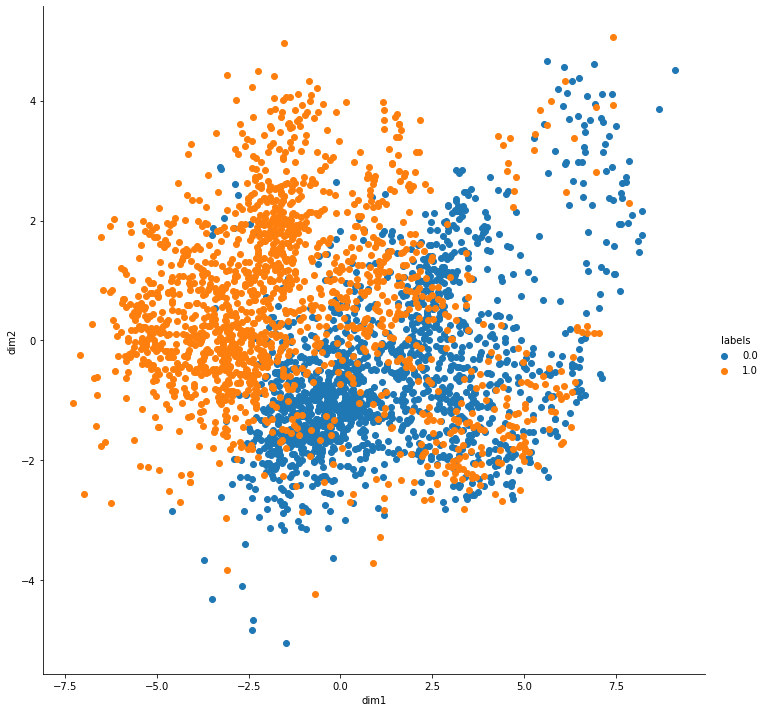

In [14]:
pca_data = np.vstack((pca_data.T, Y)).T
pca_df = pd.DataFrame(data=pca_data, columns=('dim1', 'dim2', 'labels'))
sns.FacetGrid(pca_df, hue='labels', height=10).map(plt.scatter, 'dim1', 'dim2').add_legend()

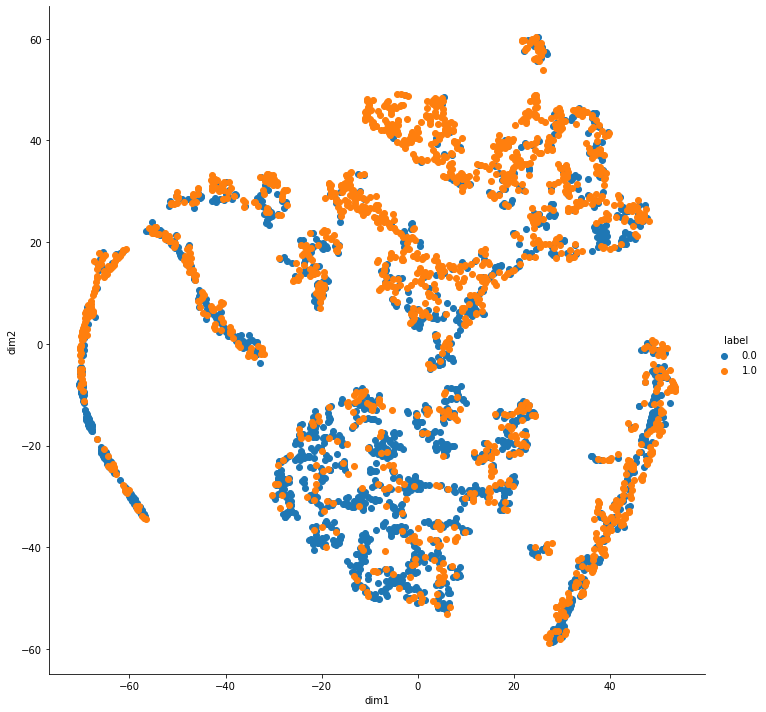

In [17]:
#APPLYING TSNE FOR DIMENSIONALTY REDUCTION
from sklearn.manifold import TSNE
model = TSNE(n_components=2, random_state=0, perplexity=30, n_iter=1000)
tsne_data = model.fit_transform(X)

tsne_data = np.vstack((tsne_data.T, Y)).T
df_tsne = pd.DataFrame(data= tsne_data, columns=('dim1', 'dim2', 'label'))

sns.FacetGrid(df_tsne, hue='label', height=10).map(plt.scatter, 'dim1', 'dim2').add_legend()

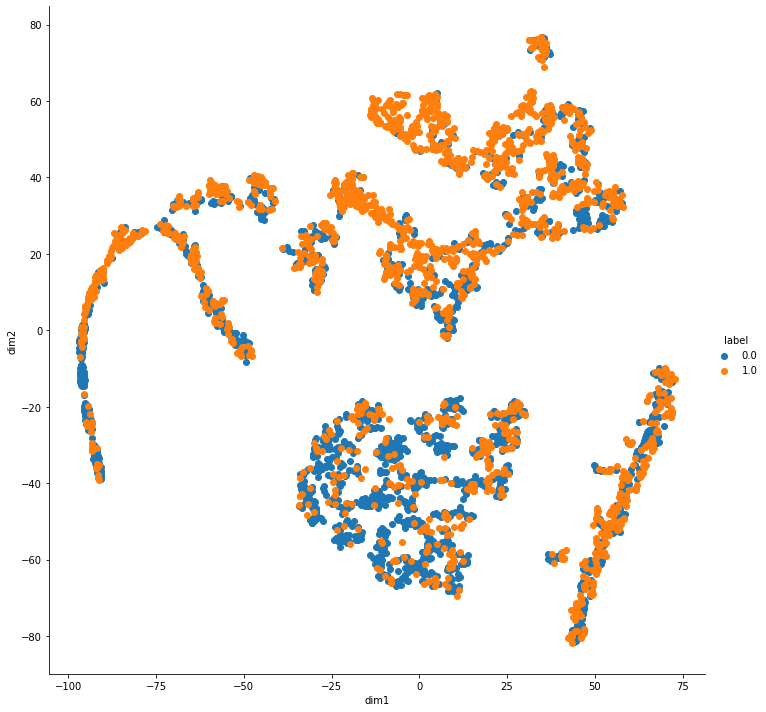

In [18]:
#APPLYING TSNE FOR DIMENSIONALTY REDUCTION
model = TSNE(n_components=2, random_state=0, perplexity=30, n_iter=5000)
tsne_data = model.fit_transform(X)

tsne_data = np.vstack((tsne_data.T, Y)).T
df_tsne = pd.DataFrame(data= tsne_data, columns=('dim1', 'dim2', 'label'))

sns.FacetGrid(df_tsne, hue='label', height=10).map(plt.scatter, 'dim1', 'dim2').add_legend()

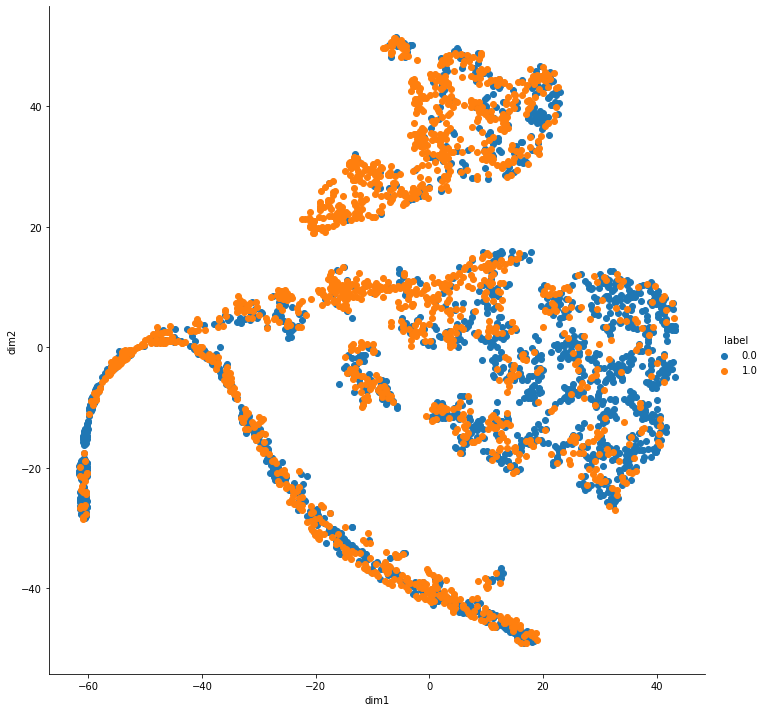

In [19]:
#APPLYING TSNE FOR DIMENSIONALTY REDUCTION
model = TSNE(n_components=2, random_state=0, perplexity=50, n_iter=1000)
tsne_data = model.fit_transform(X)

tsne_data = np.vstack((tsne_data.T, Y)).T
df_tsne = pd.DataFrame(data= tsne_data, columns=('dim1', 'dim2', 'label'))

sns.FacetGrid(df_tsne, hue='label', height=10).map(plt.scatter, 'dim1', 'dim2').add_legend()

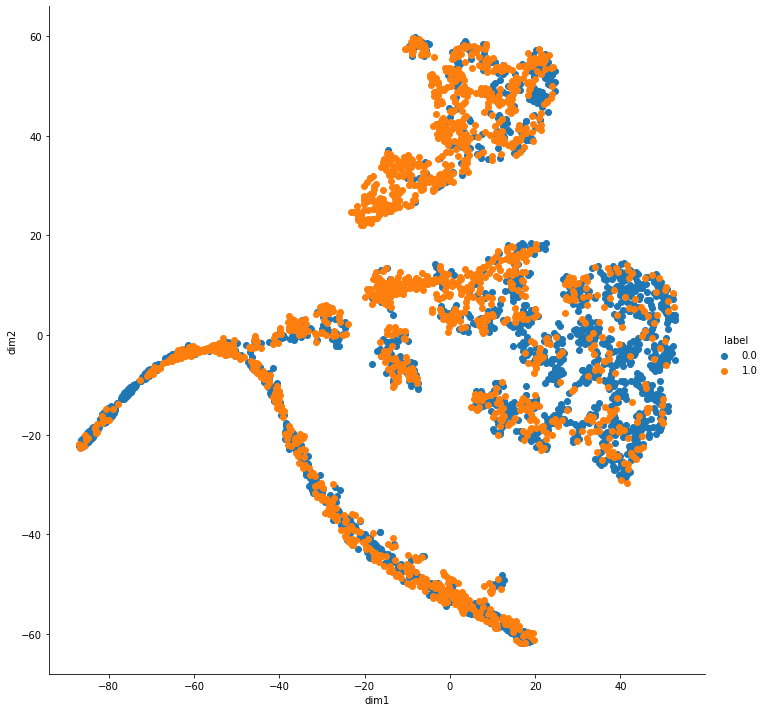

In [20]:
#APPLYING TSNE FOR DIMENSIONALTY REDUCTION
model = TSNE(n_components=2, random_state=0, perplexity=50, n_iter=5000)
tsne_data = model.fit_transform(X)

tsne_data = np.vstack((tsne_data.T, Y)).T
df_tsne = pd.DataFrame(data= tsne_data, columns=('dim1', 'dim2', 'label'))

sns.FacetGrid(df_tsne, hue='label', height=10).map(plt.scatter, 'dim1', 'dim2').add_legend()